# PPOCR Library for YSA Feasibility Testing

In [18]:
from paddleocr import PaddleOCR,draw_ocr
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display

## Text Detection

In [15]:
ocr = PaddleOCR(lang='en', use_gpu=False) # need to run only once to download and load model into memory
img_path = r"C:\Users\pcadmin\Desktop\YSA AI\Traceability\Data\19-11-2024\20241119_144922.jpg"
result = ocr.ocr(img_path,rec=False)
for idx in range(len(result)):
    res = result[idx]
    for line in res:
        print(line)
        
result = result[0]
image = Image.open(img_path).convert('RGB')
im_show = draw_ocr(image, result, txts=None, scores=None, font_path='C:/Windows/Fonts/Arial.ttf')
im_show = Image.fromarray(im_show)

[2025/01/10 12:23:06] ppocr DEBUG: Namespace(alpha=1.0, alphacolor=(255, 255, 255), benchmark=False, beta=1.0, binarize=False, cls_batch_num=6, cls_image_shape='3, 48, 192', cls_model_dir='C:\\Users\\pcadmin/.paddleocr/whl\\cls\\ch_ppocr_mobile_v2.0_cls_infer', cls_thresh=0.9, cpu_threads=10, crop_res_save_dir='./output', det=True, det_algorithm='DB', det_box_type='quad', det_db_box_thresh=0.6, det_db_score_mode='fast', det_db_thresh=0.3, det_db_unclip_ratio=1.5, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_east_score_thresh=0.8, det_limit_side_len=960, det_limit_type='max', det_model_dir='C:\\Users\\pcadmin/.paddleocr/whl\\det\\en\\en_PP-OCRv3_det_infer', det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, det_pse_thresh=0, det_sast_nms_thresh=0.2, det_sast_score_thresh=0.5, draw_img_save_dir='./inference_results', drop_score=0.5, e2e_algorithm='PGNet', e2e_char_dict_path='./ppocr/utils/ic15_dict.txt', e2e_limit_side_len=768, e2e_limit_type='max', e2e_model_dir=N

In [16]:
print(result)

[[[2478.0, 2414.0], [2691.0, 2402.0], [2694.0, 2472.0], [2482.0, 2483.0]], [[691.0, 2122.0], [904.0, 2090.0], [909.0, 2125.0], [696.0, 2156.0]], [[948.0, 2076.0], [1030.0, 2076.0], [1030.0, 2110.0], [948.0, 2110.0]], [[707.0, 2074.0], [909.0, 2045.0], [916.0, 2090.0], [713.0, 2119.0]], [[2411.0, 1485.0], [2662.0, 1463.0], [2666.0, 1514.0], [2416.0, 1535.0]], [[1186.0, 106.0], [1318.0, 117.0], [1315.0, 152.0], [1183.0, 141.0]], [[2058.0, 141.0], [2227.0, 59.0], [2254.0, 114.0], [2085.0, 197.0]]]


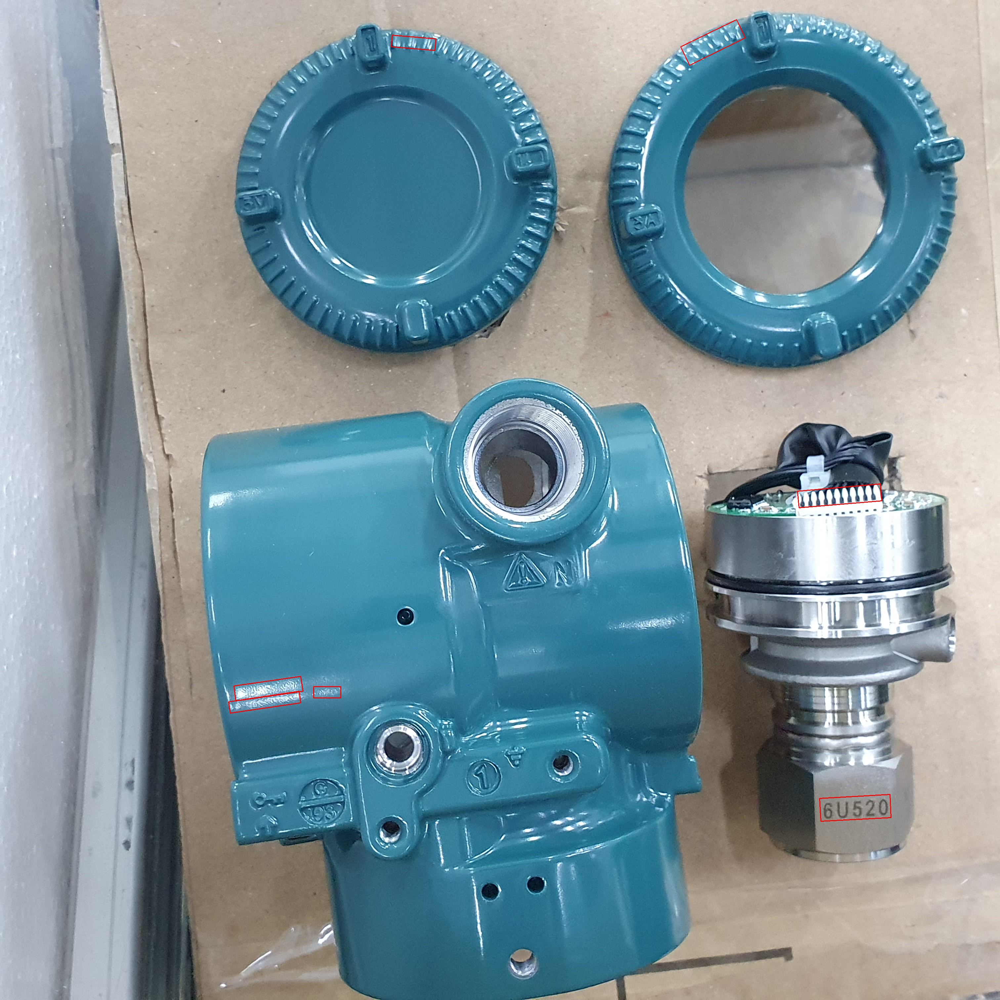

In [17]:
display(im_show)

## Sliding Window Detection and Recognition

In [19]:
# Paddleocr supports Chinese, English, French, German, Korean and Japanese
# You can set the parameter `lang` as `ch`, `en`, `french`, `german`, `korean`, `japan`
# to switch the language model in order
ocr = PaddleOCR(use_angle_cls=True, lang='en', use_gpu=False)  # Enable GPU after correct installation
img_path = r"C:\Users\pcadmin\Desktop\YSA AI\Traceability\Data\19-11-2024\20241119_144922.jpg" # Replace with your actual image filename
slice = {'horizontal_stride': 500, 'vertical_stride': 500, 'merge_x_thres': 50, 'merge_y_thres': 50}
results = ocr.ocr(img_path, cls=True, slice=slice)

# Load image
image = Image.open(img_path).convert("RGB")
draw = ImageDraw.Draw(image)
font = ImageFont.truetype("C:/Windows/Fonts/Arial.ttf", size=50)  # Adjust size as needed

# Process and draw results
for res in results:
    for line in res:
        box = [tuple(point) for point in line[0]]
        # Finding the bounding box
        box = [(min(point[0] for point in box), min(point[1] for point in box)),
               (max(point[0] for point in box), max(point[1] for point in box))]
        txt = line[1][0]
        draw.rectangle(box, outline="red", width=2)  # Draw rectangle
        draw.text((box[0][0], box[0][1] - 25), txt, fill="blue", font=font)  # Draw text above the box


[2025/01/10 12:28:50] ppocr DEBUG: Namespace(alpha=1.0, alphacolor=(255, 255, 255), benchmark=False, beta=1.0, binarize=False, cls_batch_num=6, cls_image_shape='3, 48, 192', cls_model_dir='C:\\Users\\pcadmin/.paddleocr/whl\\cls\\ch_ppocr_mobile_v2.0_cls_infer', cls_thresh=0.9, cpu_threads=10, crop_res_save_dir='./output', det=True, det_algorithm='DB', det_box_type='quad', det_db_box_thresh=0.6, det_db_score_mode='fast', det_db_thresh=0.3, det_db_unclip_ratio=1.5, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_east_score_thresh=0.8, det_limit_side_len=960, det_limit_type='max', det_model_dir='C:\\Users\\pcadmin/.paddleocr/whl\\det\\en\\en_PP-OCRv3_det_infer', det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, det_pse_thresh=0, det_sast_nms_thresh=0.2, det_sast_score_thresh=0.5, draw_img_save_dir='./inference_results', drop_score=0.5, e2e_algorithm='PGNet', e2e_char_dict_path='./ppocr/utils/ic15_dict.txt', e2e_limit_side_len=768, e2e_limit_type='max', e2e_model_dir=N

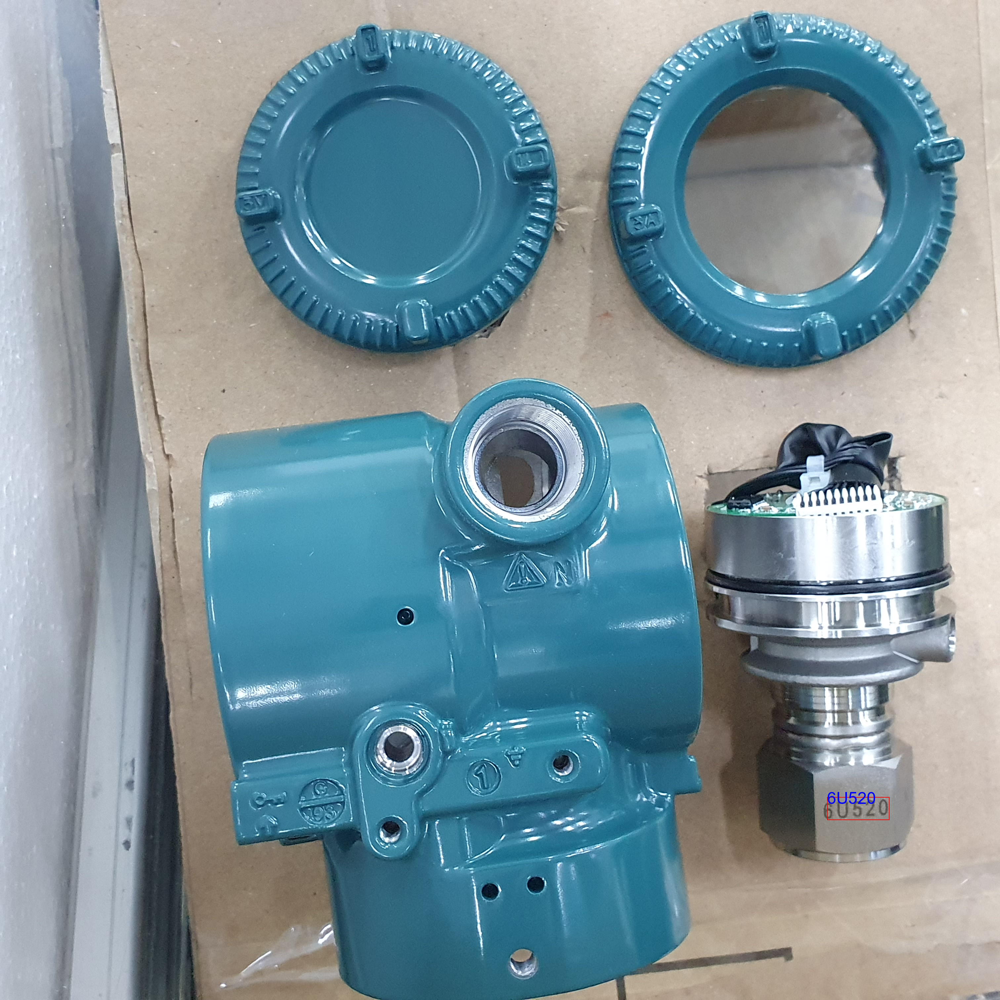

In [21]:
display(image)

In [1]:
import paddlex

print(paddlex.__version__)

3.0.0.beta2


### Data Annotation
#### ppocrlabel 
